# Regresión Lineal Multivariable 
En este caso, vamos a elegir una tercera variable predictora para agregarla al modelo

## Importando datos

In [68]:
import pandas as pd
df = pd.read_csv('./housing.csv', header=None, sep='\s+')

In [69]:
# Nombre de las columnas
column_names = ['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'RM', 'AGE', 'DIS', 'RAD', 'TAX', 'PTRATIO', 'B', 'LSTAT', 'MEDV']

In [70]:
# Asignamos el nombre de las columnas al df
df.columns = column_names
df.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0,0.538,6.575,65.2,4.0900,1,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0,0.469,6.421,78.9,4.9671,2,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0,0.469,7.185,61.1,4.9671,2,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0,0.458,6.998,45.8,6.0622,3,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0,0.458,7.147,54.2,6.0622,3,222.0,18.7,396.90,5.33,36.2


**Signicado de Nombres**:
- CRIM - per capita crime rate by town
- ZN - proportion of residential land zoned for lots over 25,000 sq.ft.
- INDUS - proportion of non-retail business acres per town.
- CHAS - Charles River dummy variable (1 if tract bounds river; 0 otherwise)
- NOX - nitric oxides concentration (parts per 10 million)
- RM - average number of rooms per dwelling
- AGE - proportion of owner-occupied units built prior to 1940
- DIS - weighted distances to five Boston employment centres
- RAD - index of accessibility to radial highways
- TAX - full-value property-tax rate per $10,000
- PTRATIO - pupil-teacher ratio by town
- B - 1000(Bk - 0.63)^2 where Bk is the proportion of blacks by town
- LSTAT - % lower status of the population
- MEDV - Median value of owner-occupied homes in $1000's

## Entendiendo los datos
Una vez descargados los datos lo que hay que hacer es entenderlos. Es importante saber que el algoritmo de regresión lineal se basa altamente en correlaciones por lo que yo recomiendo que empecemos viendo un gráfico de correlaciones usando pairplot de Seaborn.

In [71]:
import seaborn as sns
import matplotlib.pyplot as plt

In [72]:
# Estilo a los graficos
sns.set(style='whitegrid', context='notebook')

# Seleccion de las variables de interes
cols = ['DIS','INDUS','CRIM','RM','MEDV']

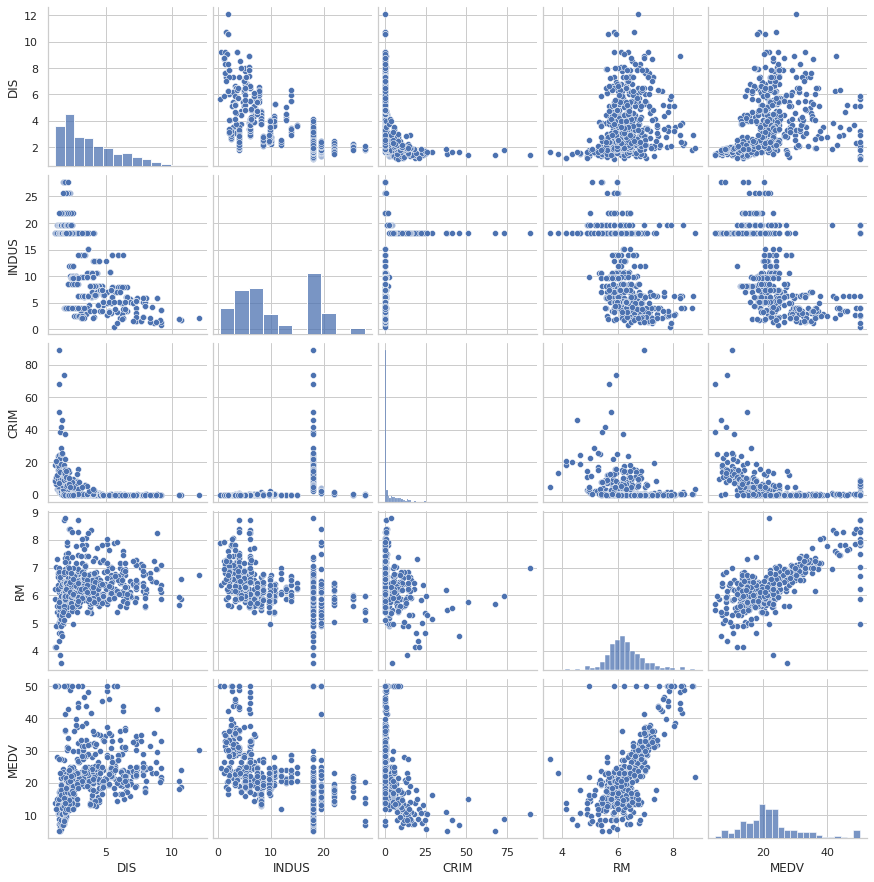

In [73]:
# Matriz de graficas que muestras todas las relaciones entre las variables
# height indica en tamano de los valores
sns.pairplot(df[cols], height=2.5);

Una vez que se ve cómo están correlacionadas las variables de manera visual es importante usar un método numérico para poder entender las correlaciones. 

In [74]:
# importamos numpy
import numpy as np

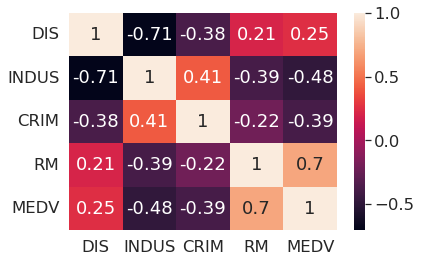

In [75]:
# calculo de correlaciones entre las variables
cm = np.corrcoef(df[cols].values.T)

# modificar tamano de valores en el grafico
sns.set(font_scale=1.5)

# heatmap para mostrar la informacion
sns.heatmap(cm, cbar=True, annot=True, yticklabels=cols, xticklabels=cols);

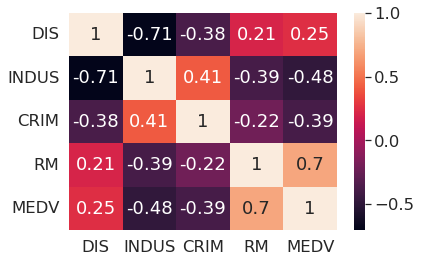

In [76]:
# otra forma alternativa de crear el heatmap con Pandas
# modificar tamano de valores
sns.set(font_scale=1.5)

#
sns.heatmap(df[cols].corr(), cbar=True, annot=True, yticklabels=cols, xticklabels=cols);

Del grafico notamos que:
- RM esta bastante correlacionado con nuestra variable objetivo (MEDV).
- La segunda variable mejor correlacionada con MEDV es INDUS y es la que vamos a utilizar en el modelo. Es una correlacion negativa

## Creando modelo con scikit-learn

In [77]:
# Importamos libreria
from sklearn.preprocessing import  StandardScaler # ayuda a escalar los datos para que el modelo se ajuste mejor a ellos
from sklearn.linear_model import LinearRegression # funcion que se utiliza para la regresion

In [78]:
# definimos la variable objetivo y las predictoras (RM e INDUS)

# variables predictoras. No requiere redimensionar
X = df[['RM', 'INDUS']].values

# Variable objetivo
z = df['MEDV'].values.reshape(-1,1)

In [86]:
# Estandarizamos los valores para ajustar mejor el modelo
sc_x = StandardScaler()
sc_z = StandardScaler()

X_std = sc_x.fit_transform(X)
z_std = sc_z.fit_transform(z)

In [80]:
# modelo de regresion lineal
slr = LinearRegression()
slr.fit(X_std, z_std)

LinearRegression()

## Análisis de la Regresion Multivariable

In [81]:
# importamos librerias para graficar en 3 dimensiones
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import *
import numpy as np

In [82]:
# Rangos del plano
x1_range = np.arange(df['RM'].min(), df['RM'].max())
x2_range = np.arange(df['INDUS'].min(), df['INDUS'].max())

# obtenemos valores de la malla
X1, X2 = np.meshgrid(x1_range, x2_range)

In [83]:
# obtenemos valores del plano
plano = pd.DataFrame({'RM':X1.ravel(), 'INDUS':X2.ravel()})
plano

,RM,INDUS
0,3.561,0.46
1,4.561,0.46
2,5.561,0.46
3,6.561,0.46
4,7.561,0.46
...,...,...
163,4.561,27.46
164,5.561,27.46
165,6.561,27.46
166,7.561,27.46


Se crea para cada valor de RM un valor de INDUS

## Generando la grafica en 3D del modelo

In [84]:
# Ajustamos la prediccion con la misma forma de X1 para que todas las variables
# cuenten con las mismas caracteristicas
pred = slr.predict(plano).reshape(X1.shape)

/home/jbernal/anaconda3/envs/data/lib/python3.10/site-packages/sklearn/base.py:432: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


In [87]:
# volvemos a los valores reales
pred = sc_z.inverse_transform(pred)

/tmp/ipykernel_1211/1648103853.py:6: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')


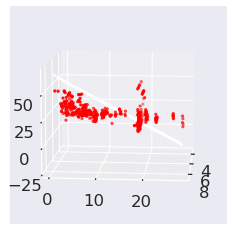

In [93]:
# graficamos el modelo
# Creamos una figura
fig = plt.figure()

# definir axis en 3D
ax = fig.gca(projection='3d')

# Crear el plano de la prediccion. alpha coloca una transparencia a la figura
ax.plot_surface(X1,X2,pred,alpha=0.6)

# graficar los valores reales
ax.scatter3D(df['RM'], df['INDUS'], df['MEDV'], color='Red', marker='.')

# cambiar orientacion de la vista del grafico
ax.view_init(elev=10, azim=5)

plt.show()

## Uso de plotly

In [96]:
# Librerias
import plotly.express as px
import plotly.graph_objects as go

In [98]:
# Entrenamiento del modelo
X = df[['RM', 'INDUS']].values
y = df['MEDV'].values.reshape(-1, 1)

slr = LinearRegression()
slr.fit(X, y)

LinearRegression()

In [99]:
# Grafica del modelo
mesh_size = .02
margin = 0

# Crear malla donde mostrar el modelo
x_min, x_max = X[:,0].min() - margin, X[:,0].max() + margin
y_min, y_max = X[:,1].min() - margin, X[:,1].max() + margin

xrange = np.arange(x_min, x_max, mesh_size)
yrange = np.arange(y_min, y_max, mesh_size)

xx, yy = np.meshgrid(xrange, yrange)

In [100]:
# Correr el modelo
pred = slr.predict(np.c_[xx.ravel(), yy.ravel()])
pred = pred.reshape(xx.shape)

In [101]:
# Generar el grafico
fig = px.scatter_3d(df, x='RM', y='INDUS', z='MEDV')
fig.update_traces(marker=dict(size=5))
fig.add_traces(go.Surface(x=xrange, y=yrange, z=pred, name='pred_surface'))
fig.show()